In [108]:
!pip install metloom
#!pip install zarr
#!pip install pint-xarray
import numpy as np
from datetime import datetime
import pandas as pd
import geopandas as gpd
from metloom.pointdata import SnotelPointData, USGSPointData
from metloom.variables import SensorDescription, SnotelVariables, USGSVariables
from matplotlib import pyplot as plt
import xarray as xr
import shapely
import os
from glob import glob
import numpy as np
import xarray as xr
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
from matplotlib.widgets import RangeSlider
import holoviews as hv
import hvplot.xarray 
import rioxarray
from pathlib import Path
import ee
import pyproj
import matplotlib.patheffects as pe

http://earthpy.org/flow.html

In [2]:
stream_data_dir = f'{Path.home()}/FlakesAndFlows/data/stream/usgs_instantaneous_1980_2024.zarr'

In [63]:
snotel = xr.open_dataset(f'{Path.home()}/FlakesAndFlows/data/snotel/snotel_hourly_1980_2024.zarr')
usgs = xr.open_dataset(f'{Path.home()}/FlakesAndFlows/data/stream/usgs_instantaneous_1980_2024.zarr')

/opt/conda/lib/python3.11/site-packages/zarr/codecs/vlen_utf8.py:44: UserWarning: The codec `vlen-utf8` is currently not part in the Zarr format 3 specification. It may not be supported by other zarr implementations and may change in the future.
  return cls(**configuration_parsed)
/opt/conda/lib/python3.11/site-packages/zarr/codecs/vlen_utf8.py:44: UserWarning: The codec `vlen-utf8` is currently not part in the Zarr format 3 specification. It may not be supported by other zarr implementations and may change in the future.
  return cls(**configuration_parsed)


In [4]:
beaver_creek_snotel_point = shapely.geometry.Point(-120.99, 48.528, 4310)
thunder_basin_snotel_point = shapely.geometry.Point(-121.256, 48.879, 3630)
thunder_creek_usgs_point = shapely.geometry.Point(-121.07290, 48.67263, 1220.00000)
beaver_creek_usgs_point = shapely.geometry.Point(-121.07343, 48.77759, 1610.23000)
snotel_points = [beaver_creek_snotel_point, thunder_basin_snotel_point]
usgs_points = [thunder_creek_usgs_point, beaver_creek_usgs_point]
snotel_points = shapely.multipoints(snotel_points)
usgs_points = shapely.multipoints(usgs_points)

In [67]:
usgs_site_mapping = {
    '12175500': 'Thunder Creek USGS Site',
    '12172000': 'Beaver Creek USGS Site'
}

snotel_site_mapping = {
    '990:WA:SNTL': 'Thunder Basin Snotel Site',
    '817:WA:SNTL': 'Beaver Creek Snotel Site'
}

usgs['site'] = usgs['site'].to_pandas().map(usgs_site_mapping)

snotel['site'] = snotel['site'].to_pandas().map(snotel_site_mapping)


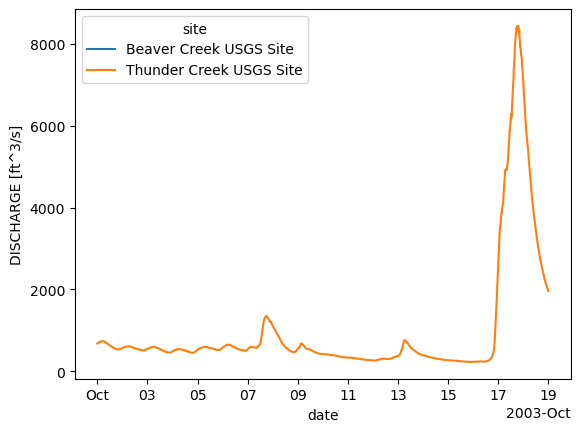

In [6]:
usgs_winter_2023 = usgs.sel(date=slice('2003-10-01', '2003-10-18'))
usgs_winter_2023.DISCHARGE.plot.line(x='date', hue='site')
#a gap in the data at 2003-09-21

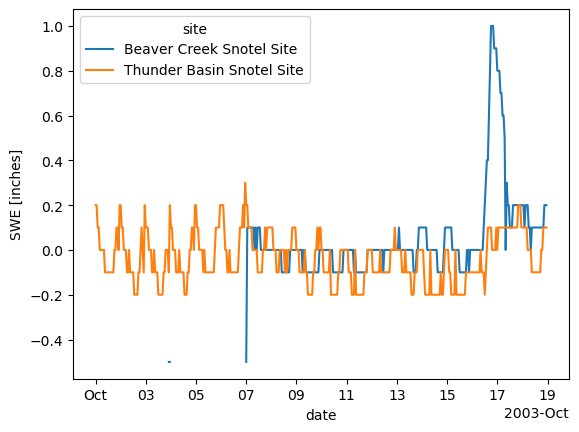

In [7]:
snotel_winter_2023 = snotel.sel(date=slice('2003-10-01', '2003-10-18'))
snotel_winter_2023.SWE.plot.line(x='date', hue='site')
#seems to be data anomolies around 2003-04-08 and 2001-09-15

*This is my attempt to find time that have high flows but i think i need to look at each site individually and also have a rolling std*

In [8]:
# Drop NaN values from 'DISCHARGE'
usgs_clean = usgs.dropna(dim='date', subset=['DISCHARGE'])

percentile_threshold = np.percentile(usgs_clean['DISCHARGE'].values, 90)
print(f"90th Percentile Threshold: {percentile_threshold}")


90th Percentile Threshold: 1160.0


In [9]:
percentile_threshold = np.percentile(usgs['DISCHARGE'].values, 90)
print(f"90th Percentile Threshold: {percentile_threshold}")

90th Percentile Threshold: nan


In [10]:
#usgs_winter_2023 = years_usgs.sel(date=slice(0, 19))
#usgs_winter_2023.DISCHARGE.plot.line(x='date', hue='site')

sites = ['12172000', '12175500']


usgs['mon'] = usgs['date'].dt.month


j = {}


ymin = 50
ymax = 8500

for i in range(0, len(sites)):  
    site = sites[i]

    
    if site in usgs.site.values:  
        
        site_data = usgs.sel(site=site).to_dataframe().reset_index()

        j[site] = site_data.groupby('mon')['DISCHARGE'].agg(['min', 'mean', 'median', 'max', 'std', 'size']).reset_index()

        # Create custom labels showing month and sample size
        labs = [months[str(j[site]['mon'][b])] + " (n=" + str(int(j[site]['size'][b])) + ")" for b in range(len(j[site]))]

        # Define tick locations for each month
        tickloc = [b + 1 for b in range(len(j[site]['mon']))]

        # Create the boxplot
        plt.figure()
        site_data.boxplot(column='DISCHARGE', by='mon', rot=70)

        # Customizations for the plot
        plt.title(f"Boxplot for Site {site}")  # Add a title indicating the site
        plt.suptitle('')
        plt.yscale('log')  # Log scale for the y-axis
        plt.ylabel('Discharge (cfs)')
        plt.ylim((ymin, ymax))  # Define y-axis limits (ensure positive values)
        plt.xlabel('Month')

        # Apply custom labels to x-ticks
        plt.xticks(tickloc, labs)

        # Show and close the plot
        plt.show()
        plt.close()


discharge=usgs.DISCHARGE

discharge.dims

discharge.attrs

In [11]:
import hvplot.xarray 

THUNDER_CREEK_USGS = ('12175500', 'Thunder Creek USGS Site')
BEAVER_CREEK_USGS = ('12172000', 'Beaver Creek USGS Site')

THUNDER_BASIN_SNOTEL = ('990:WA:SNTL', 'Thunder Basin Snotel Site')
BEAVER_CREEK_SNOTEL = ('817:WA:SNTL', 'Beaver Creek Snotel Site')

In [12]:
def calculate_date_range(date_str):
    date = pd.Timestamp(date_str)  # Convert string to pandas Timestamp
    start_date = date - pd.DateOffset(days=2)
    end_date = date + pd.DateOffset(days=2)
    return start_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d")

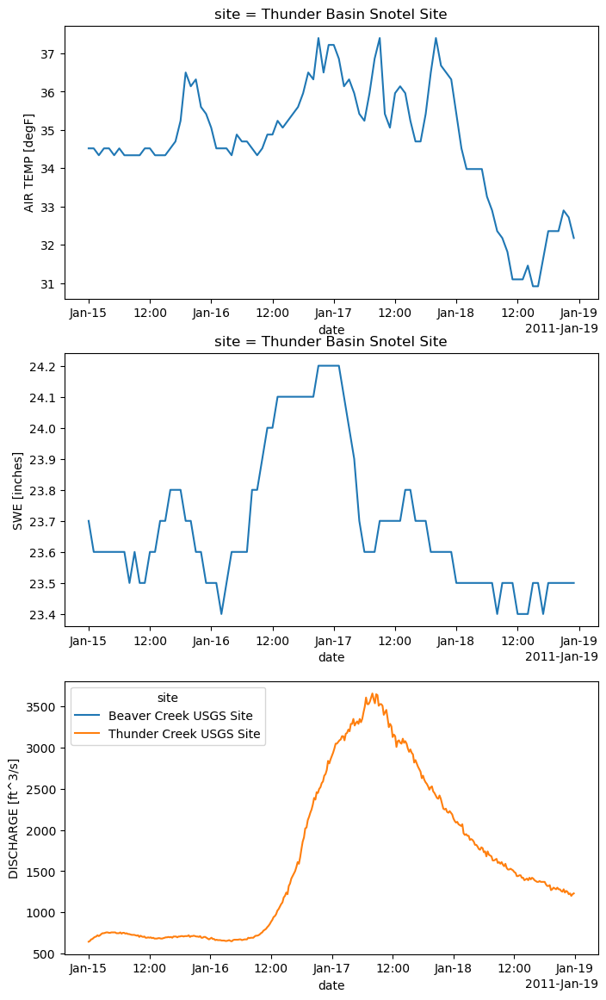

In [13]:
snotel_winter_1 = snotel.sel(site='Thunder Basin Snotel Site',date=slice('2011-01-15', '2011-01-18'))
usgs_winter_1 = usgs.sel(date=slice('2011-01-15', '2011-01-18'))

fig, ax = plt.subplots(3,1,figsize=(8, 14))
snotel_winter_1['AIR TEMP'].plot.line(ax=ax[0],x='date', hue='site')
snotel_winter_1['SWE'].plot.line(ax=ax[1],x='date', hue='site')
usgs_winter_1.DISCHARGE.plot.line(ax=ax[2],x='date', hue='site')

In [151]:

def testing_thunder(date):
    start_date, end_date = calculate_date_range(date)

    snotel_winter = snotel.sel(site='Thunder Basin Snotel Site',date=slice(start_date, end_date))
    usgs_winter = usgs.sel(site="Thunder Creek USGS Site", date=slice(start_date, end_date))

    fig, ax = plt.subplots(figsize=(8, 8))

    ax1 = ax.twinx()
    #ax2 = ax.twinx()
    
    #snotel_winter_2['AIR TEMP'].plot.line(ax=ax)
    
    series = usgs_winter['DISCHARGE'].resample(date='3h').mean().to_series()
 
    ax.bar(series.index, series.values, edgecolor='black', color='cornflowerblue',alpha=0.2, label='Discharge', width=0.1,zorder=1)
    #ax.set_ylim(ymin=0, ymax=4000)
    for i in range(1, len(snotel_winter['date'])):
        color = 'red' if snotel_winter['AIR TEMP'].values[i] > 32 else 'darkblue'
        ax1.plot(snotel_winter['date'][i-1:i+1], snotel_winter['SWE'].values[i-1:i+1], color=color, zorder=5)

  
    ax.set_xlabel('Date')
    ax.set_ylabel('Discharge (cfs)', color='cornflowerblue')  
    ax1.set_ylabel('SWE (inches)', color='black') 
    ax.set_title('Rain on Snow Events')
   
    return fig, ax

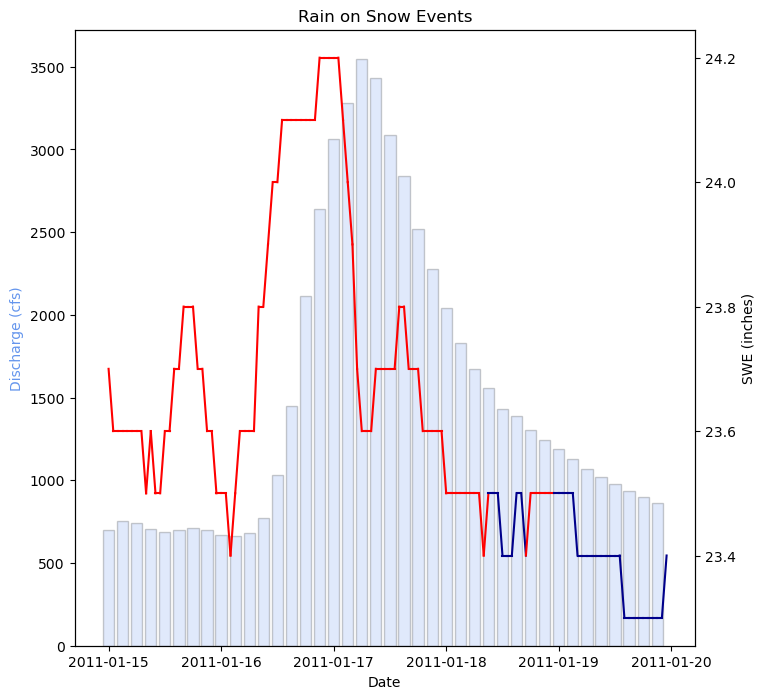

In [152]:
testing_thunder('2011-01-17');
#yes

In [153]:
def testing_beaver(date):
    start_date, end_date = calculate_date_range(date)

    snotel_winter = snotel.sel(site='Beaver Creek Snotel Site',date=slice(start_date, end_date))
    usgs_winter = usgs.sel(site="Beaver Creek USGS Site", date=slice(start_date, end_date))

    fig, ax = plt.subplots(figsize=(8, 8))

    ax1 = ax.twinx()
    #ax2 = ax.twinx()
    
    #snotel_winter_2['AIR TEMP'].plot.line(ax=ax)
    
    series = usgs_winter['DISCHARGE'].resample(date='3h').mean().to_series()
 
    ax.bar(series.index, series.values, edgecolor='black', color='cornflowerblue',alpha=0.2, label='Discharge', width=0.1,zorder=1)
    #ax.set_ylim(ymin=0, ymax=4000)
    for i in range(1, len(snotel_winter['date'])):
        color = 'red' if snotel_winter['AIR TEMP'].values[i] > 32 else 'darkblue'
        ax1.plot(snotel_winter['date'][i-1:i+1], snotel_winter['SWE'].values[i-1:i+1], color=color, zorder=5)

  
    ax.set_xlabel('Date')
    ax.set_ylabel('Discharge (cfs)', color='cornflowerblue')  
    ax1.set_ylabel('SWE (inches)', color='black') 
    ax.set_title('Rain on Snow Events')
    return fig, ax

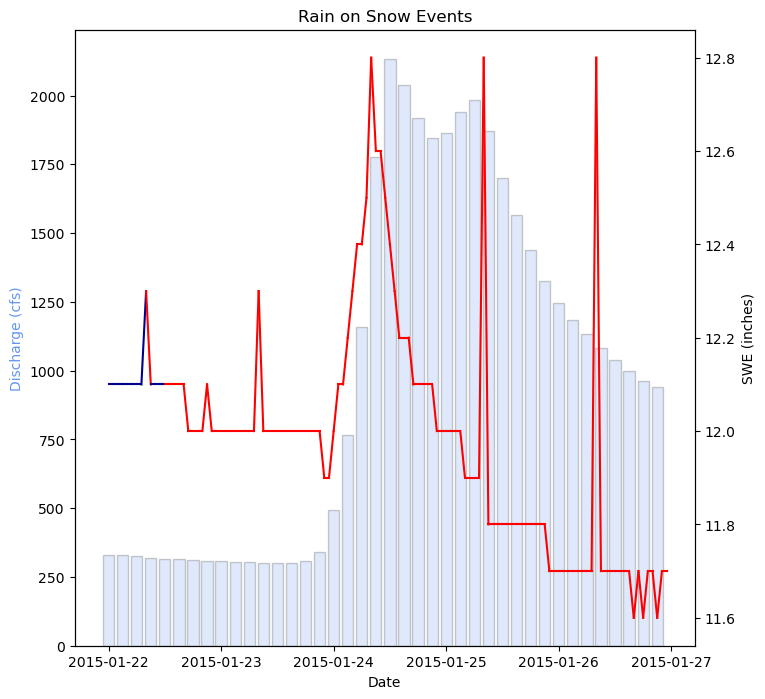

In [154]:
testing_thunder('2015-01-24');
#yes?

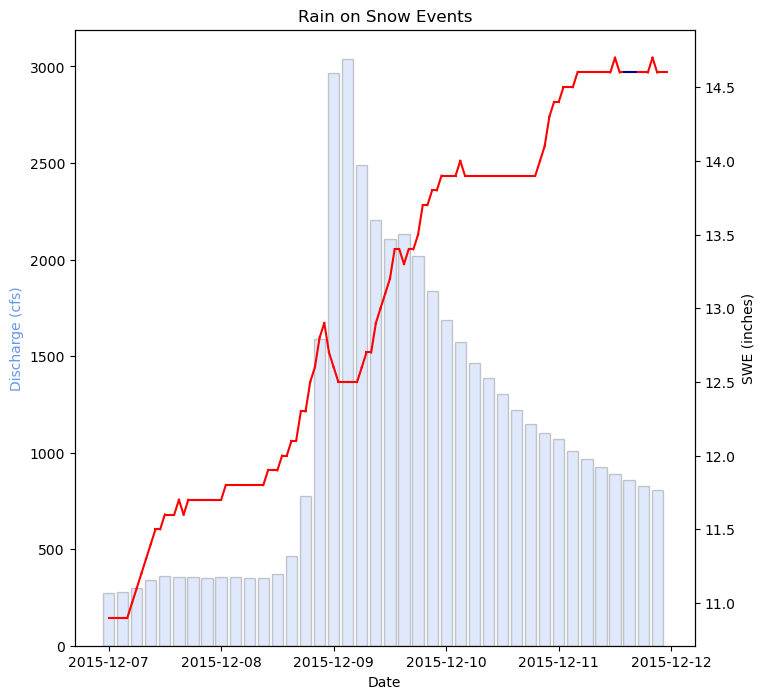

In [155]:
testing_thunder('2015-12-09');
#yes

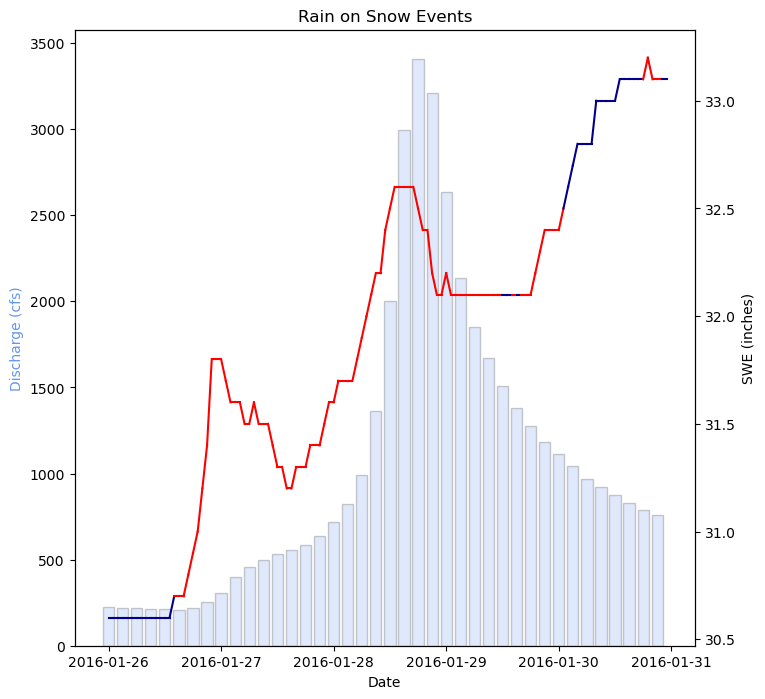

In [156]:
testing_thunder('2016-01-28');
#yes

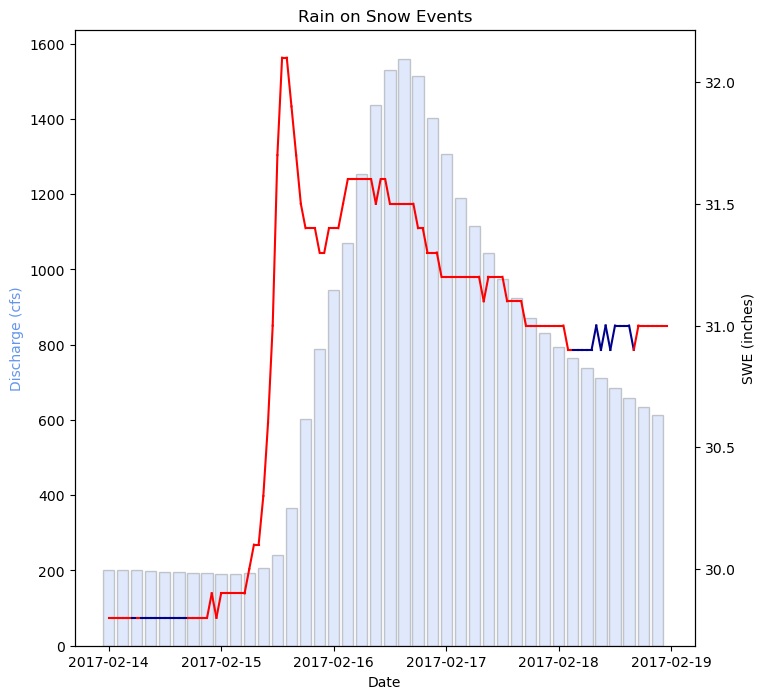

In [157]:
testing_thunder('2017-02-16');
#yes

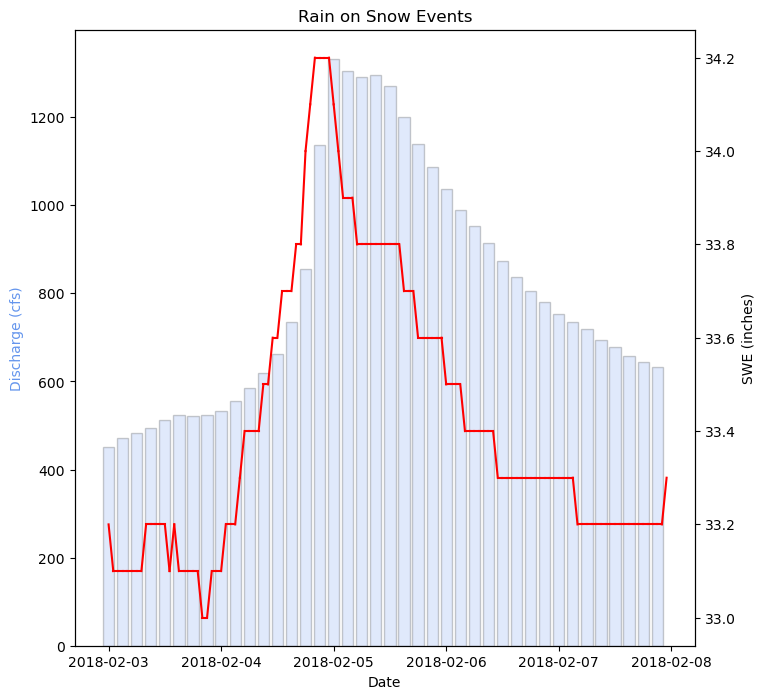

In [158]:
testing_thunder('2018-02-05');
#yes

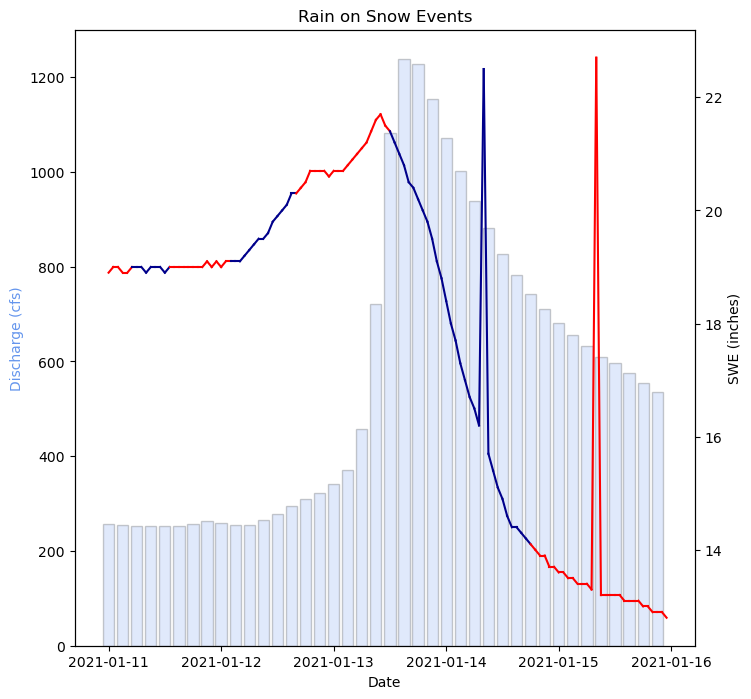

In [159]:
testing_beaver('2021-01-13');
#maybe

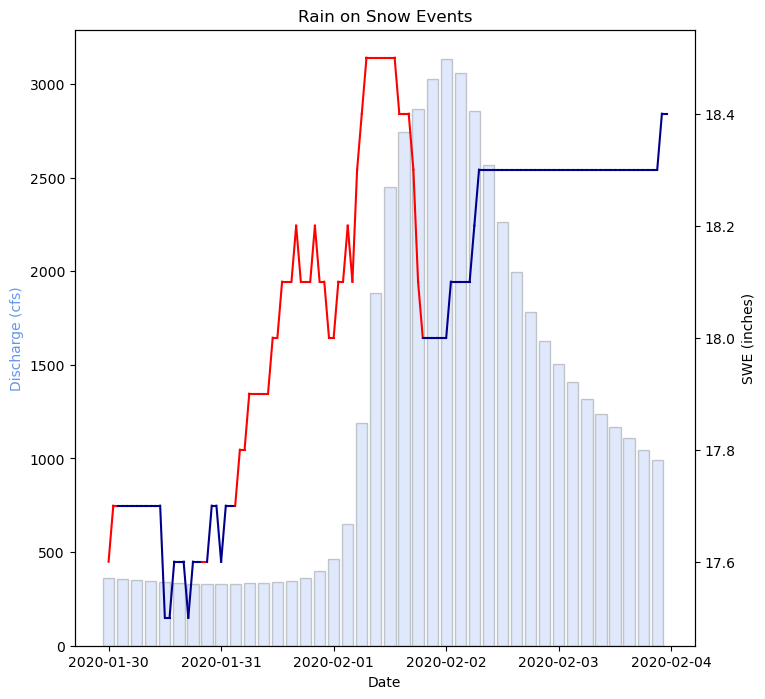

In [160]:
testing_beaver('2020-02-01');


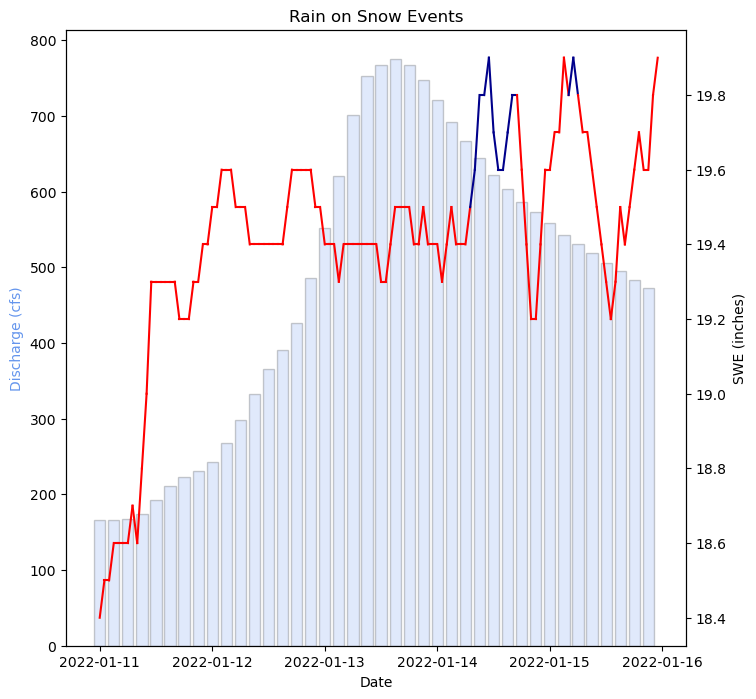

In [161]:
testing_beaver('2022-01-13');
#doesnt really work

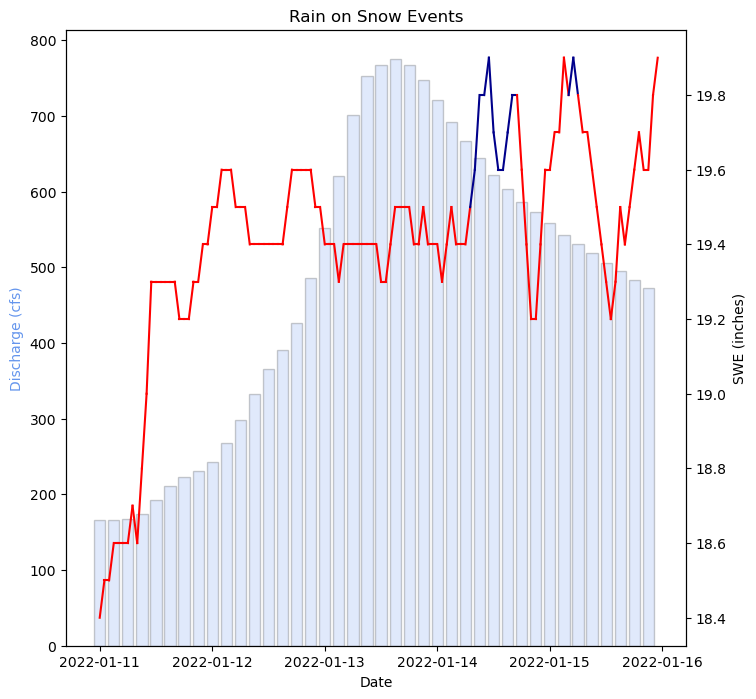

In [164]:
testing_beaver('2022-01-13');

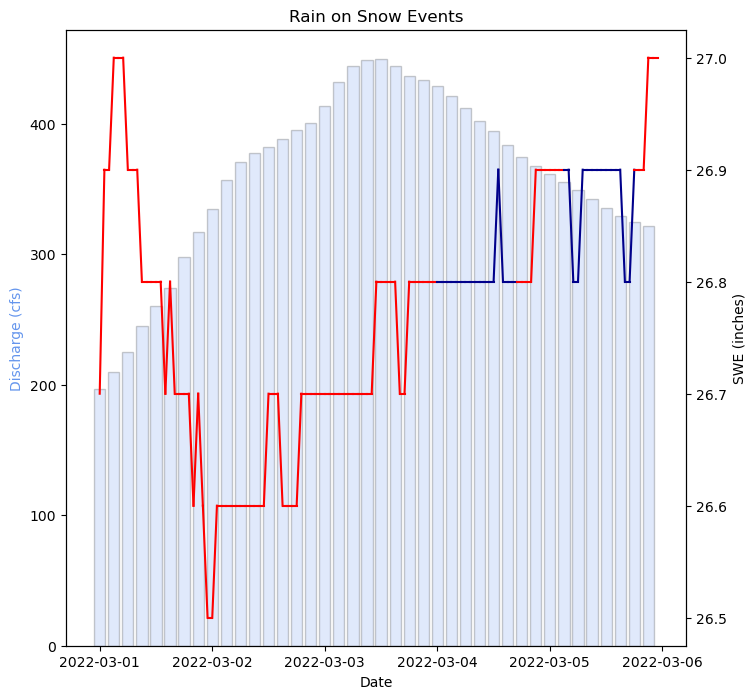

In [165]:
testing_beaver('2022-03-03');

In [17]:
usgs['DISCHARGE'].sel(date=slice('2000-01-01 00:00:00','2023-12-24 02:00:00')).hvplot(x='date',y='DISCHARGE')

#thunder
#2011-01-17
#2014-03-09
#2015-02-07 maybe not 
#2015-01-24
#2015-12-09
#2016-01-29
#2017-02-16
#2018-02-05
#2017-03-15

#beaver
#2021-01-13 maybe not
#2020-02-01
#2022-01-13 maybe nor
#2023-01-14
#2023-03-03

:DynamicMap   [site]
   :Curve   [date]   (DISCHARGE)

In [41]:
snotel['SWE'].sel(date=slice('2005-05-01 00:00:00','2023-12-24 02:00:00')).hvplot(x='date',y='SWE')
#2011-01-16
#2014-03-09

:DynamicMap   [site]
   :Curve   [date]   (SWE)

In [40]:
snotel['AIR TEMP'].sel(date=slice('2005-05-01 00:00:00','2023-12-24 02:00:00')).hvplot(x='date',y='AIR TEMP')
#2011-01-16

:DynamicMap   [site]
   :Curve   [date]   (AIR TEMP)

In [ ]:
snotel['AIR TEMP'].sel(date='1994-05-27 14:00:00')


Site 12175500 1995-11-30, alot of the peak SWE points for 990:WA:SNTL are around april
i think it would be helpful ot have a rolling for like hourly n=4


In [23]:
usgs['date_only']=usgs['date'].dt.date

In [24]:
seasonal_usgs = usgs['DISCHARGE'].groupby('date.season').median()


In [27]:
seasonal_usgs.plot(y='SEASON',x='season')

ValueError: y must be one of None, 'season', 'site'. Received 'DISCHARGE' instead.